## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import os
import numpy as np
import cv2
import glob
import imageio
imageio.plugins.ffmpeg.download()
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

In [2]:
IMG_SIZE = (1280, 720)
TEST_IMAGE_DIRECTORY = "test_images/"
OUTPUT_IMAGE_DIRECTORY = "output_images/"
Y_GLOBAL_HIGH = 461
Y_GLOBAL_LOW = 720
TRANSFORM_SRC = np.float32([(574, Y_GLOBAL_HIGH), (706, Y_GLOBAL_HIGH), (1122, Y_GLOBAL_LOW), (185, Y_GLOBAL_LOW)])
TRANSFORM_DST = np.float32([(320, 0), (960, 0), (960, 720), (320, 720)])
Y_CURVATURE_POINT = 720
LAST_LEFT_FIT, LAST_RIGHT_FIT = None, None
FOUND_LANES = []

In [3]:
from functions.helper import *

In [4]:
from functions.camera_calibration import calibration_preparation, calibrate, undistort
from functions.perspective_transform import perspective_transform_matrix, warp_image
from functions.threshold import combined_thresholding
from functions.lane_line_search import lane_line_search
from functions.visual import visualize_lane_area, visualize_texts, visualize_fit, visualize_margin

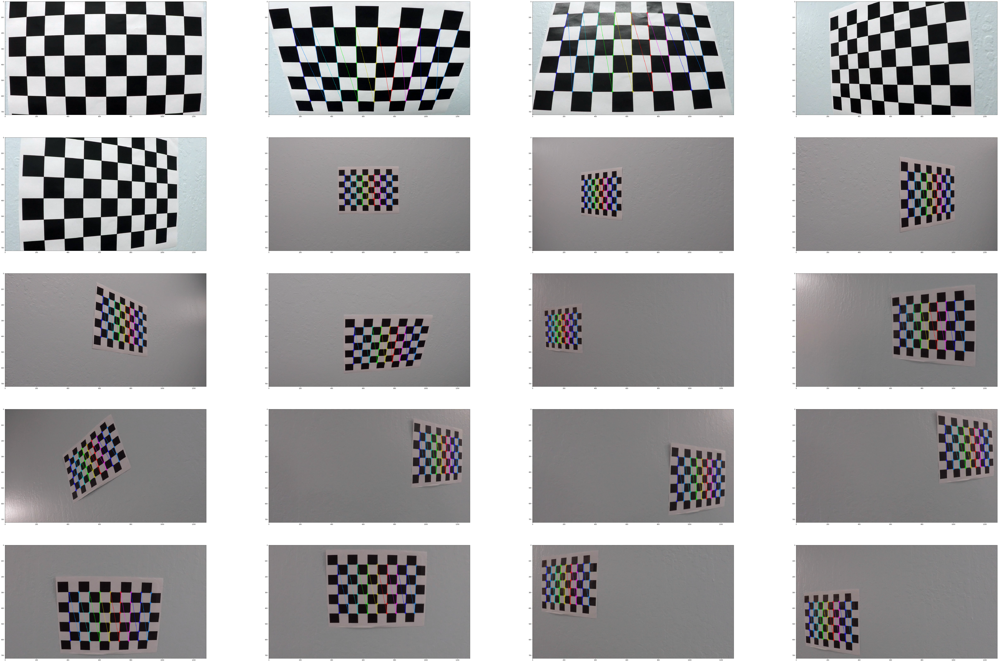

In [5]:
objpts, imgpts = calibration_preparation(6, 9)
M = perspective_transform_matrix(TRANSFORM_SRC, TRANSFORM_DST)
M_INV = perspective_transform_matrix(TRANSFORM_DST, TRANSFORM_SRC)

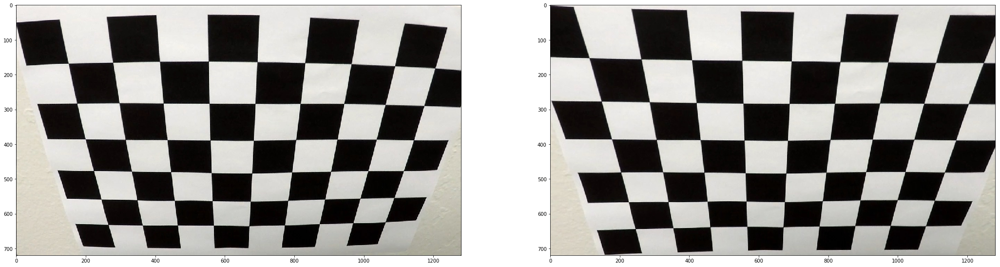

In [6]:
img = mpimg.imread('camera_cal/calibration02.jpg')
mtx, dist = calibrate(objpts, imgpts, (img.shape[1], img.shape[0]))
undistorted = undistort(mtx, dist, img)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(36, 20))
ax1.imshow(img)
ax2.imshow(undistorted)
plt.savefig('output_images/undistorted_calibration.jpg')

In [7]:
img = mpimg.imread(TEST_IMAGE_DIRECTORY + 'test5.jpg')
undistorted = undistort(mtx, dist, img)
mpimg.imsave('output_images/undistorted_test5.jpg', undistorted)

In [8]:
def process_image(mtx, dist, warp_matrix, inv_warp_matrix, sanity_check, look_back, steps, img):
    global FOUND_LANES, LAST_LEFT_FIT, LAST_RIGHT_FIT
    processed_image = np.copy(img)
    left_fit = right_fit = fit_visual = avg_left_fit = avg_right_fit = left_curverad = right_curverad = None
    if steps >= 1:
        processed_image = undistort(mtx, dist, processed_image)
    if steps >= 2:
        processed_image = combined_thresholding(processed_image)
    if steps >= 3:
        processed_image = warp_image(warp_matrix, processed_image)
    if steps >= 5:
        left_fit, right_fit, fit_visual = lane_line_search(LAST_LEFT_FIT, LAST_RIGHT_FIT, processed_image)
        if not sanity_check or parallelization_check(left_fit, right_fit, [0.0001, 0.07]):
            FOUND_LANES.append((left_fit, right_fit))
            LAST_LEFT_FIT, LAST_RIGHT_FIT = left_fit, right_fit
        avg_left_fit, avg_right_fit = averaging_fit(FOUND_LANES, look_back)
        left_curverad = curvature_rad(pix_to_real(avg_left_fit), Y_CURVATURE_POINT * YM_PER_PIX)
        right_curverad = curvature_rad(pix_to_real(avg_right_fit), Y_CURVATURE_POINT * YM_PER_PIX)
    
    if steps >= 5:
        fit_visual = visualize_fit(avg_left_fit, avg_right_fit, fit_visual)
        processed_image = visualize_margin(avg_left_fit, avg_right_fit, fit_visual)
    if steps >= 6:
        processed_image = visualize_lane_area(avg_left_fit, avg_right_fit, img)
        processed_image = warp_image(inv_warp_matrix, processed_image)
        processed_image = cv2.addWeighted(img, 1, processed_image, 0.5, 0)
    if steps >= 7:
        processed_image = visualize_texts(processed_image, (left_curverad + right_curverad) / 2,
                                          distance_to_center(avg_left_fit, avg_right_fit))
    return processed_image

In [9]:
def lane_finding_pipeline(objpoints, imgpoints, warp_matrix, inv_warp_matrix, sanity_check, look_back, steps, img_size):
    mtx, dist = calibrate(objpoints, imgpoints, img_size)
    def process_with(img):
        return process_image(mtx, dist, warp_matrix, inv_warp_matrix, sanity_check, look_back, steps, img)
    return process_with

In [10]:
test_images = os.listdir(TEST_IMAGE_DIRECTORY)
print(test_images)
# test_images = test_images[0:1]
# img = mpimg.imread(TEST_IMAGE_DIRECTORY + test_images[0])
# img = rgb2gray(img)
# img = np.dstack((img, img, img))
# cv2.rectangle(img, (320, 240), (960, 480), (0, 255, 0), 2)
# plt.imshow(img, cmap='gray')
# print(img.shape)
# print(img[int(img.shape[0] / 2):, :].shape)

['straight_lines1.jpg', 'straight_lines2.jpg', 'test1.jpg', 'test2.jpg', 'test3.jpg', 'test4.jpg', 'test5.jpg', 'test6.jpg']


In [11]:
%load_ext autoreload
%autoreload 2

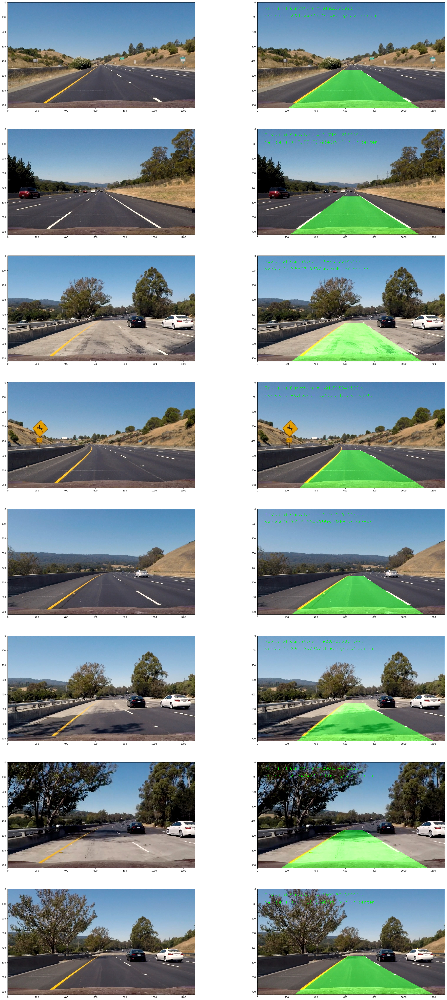

In [15]:
lane_finding_func = lane_finding_pipeline(objpts, imgpts, M, M_INV, False, 1, 10, IMG_SIZE)
fig, axes = plt.subplots(nrows=len(test_images), ncols=2, figsize=(36, 10 * len(test_images)), squeeze=False)
for k, test_img in enumerate(test_images):
    source_img = mpimg.imread(TEST_IMAGE_DIRECTORY + test_img)
    axes[k][0].imshow(source_img, cmap='gray')
    processed_img = lane_finding_func(source_img)
    # Display images, cmap is ignored when it's rgb
    axes[k][1].imshow(processed_img, cmap='gray')
    mpimg.imsave('output_images/' + test_img, processed_img, cmap='gray')
    LAST_LEFT_FIT, LAST_RIGHT_FIT = None, None
    FOUND_LANES = []
    
plt.show()

In [ ]:
LAST_LEFT_FIT, LAST_RIGHT_FIT = None, None
project_video_output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")#.subclip(0, 5)
lanes_clip = clip1.fl_image(lane_finding_pipeline(objpts, imgpts, M, M_INV, True, 3, 10, IMG_SIZE))
lanes_clip.write_videofile(project_video_output, audio=False)

In [ ]:
HTML("""
<video width="640" height="360" controls>
  <source src="{0}">
</video>
""".format(project_video_output))

In [ ]:
%who